# Uber vs Bikes in Manhattan - A study with Python
***

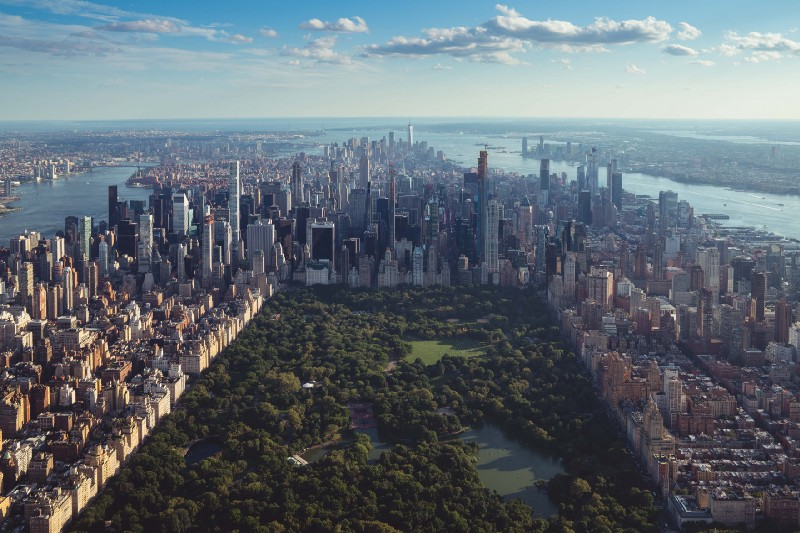
<br>
Welcome to my Manhattan Mobility Study! We are going to take dive into the Big Apple and try to get a better understanding of two of its forms of transportation: a Bike Sharing System and Uber Rides.

How are each of them used throughout the day? Is there a big difference in their use between weekends and week days? Which are the favorite districts for cyclists? How is the dynamic of a neighborhood very popular among tourists? What about local workers?

We are going to try to answer some of these questions using python, with a little help from folium, a very powerful library that will help us make some beautiful maps! You can see the full project in [my github](https://github.com/DanielEliezer/).

In [1]:
### Importing Libraries

## manipulation
import pandas as pd
import numpy as np
import datetime as dt
from itertools import product

## dataviz
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import matplotlib.dates as mdates
from matplotlib.colors import ListedColormap
import branca
import branca.colormap as cm

## maps
import folium
from folium.plugins import HeatMap
import geopandas as gpd

## misc
import imageio
import os
import time
from selenium import webdriver

## Colors
c_gray = '#414647'
c_darkblue = '#113774'
c_darkblue2 = '#0e4f66'

In [2]:
### Functions

def classify_time_group(time):
    """ Receives a integer representing the hour, and classify it in 'morning', 'afternoon' or night."""
    if time <= 5:
        return 'night'
    elif time <= 11:
        return 'morning'
    elif time <= 18:
        return 'afternoon'
    else:
        return 'night'
    


def generate_scale(values, n):
    """ Receives an array with floats, and returns a list with the thresholds of n intervals. """
    maxv = values.max()
    minv = values.min()
    n_range = maxv - minv
    myscale = [(minv + (n_range/(n-1))*i) for i in range(n)]
    return myscale


def generate_geojson(df):
    """ Receives a dataframe, and returns a geodataframe, with some 
    new spatial information collected from the nyc_neighborhoods_map, such as the district of the trip"""
    
    ## create a geodataframe from the dataframe passed
    geodf_manhattan = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df['start_longitude'], df['start_latitude']), crs = nyc_neighborhoods_map.crs).reset_index(drop = True)
    
    ## join this geodataframe with the nyc_neighborhoods_map, that contains the district limits of NYC
    new_geodf = gpd.sjoin(geodf_manhattan, nyc_neighborhoods_map, predicate = 'within')
    return new_geodf

def generate_choropleth_map(df, value_to_plot, legend = '', alias_label = '',div = 7, title = None):
    """ Receives a dataframe, with information aggregated by the district, and returns a Choropleth Map"""
    
    # Create a geodataframe, joining the df received, and the nyc map
    geodf_final = pd.merge(nyc_neighborhoods_map, df, on = 'ntaname')
    
    # Create the map in the background
    map_to_plot = folium.Map(location=[y_map, x_map], zoom_start=12,tiles=None)
    folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(map_to_plot)
    
    # set some parameters of the choropleth map
    style_function = lambda x: {'fillColor': '#ffffff', 
                                'color':'#000000', 
                                'fillOpacity': 0.1, 
                                'weight': 0.1}
    highlight_function = lambda x: {'fillColor': '#000000', 
                                    'color':'#000000', 
                                    'fillOpacity': 0.50, 
                                    'weight': 0.1}
    
    # create the color scale thresholds
    myscale = generate_scale(geodf_final[value_to_plot],div)
    
    # generate choropleth map
    folium.Choropleth(
    geo_data=geodf_final,
    name='Choropleth',
    data=geodf_final,
    columns=['ntaname',value_to_plot],
    key_on="feature.properties.ntaname",
    fill_color='YlGnBu',
    threshold_scale=myscale,
    fill_opacity=1,
    line_opacity=0.5,
    legend_name=legend,
    smooth_factor=0).add_to(map_to_plot)
    
    # create the title of the map (optional)
    if title != None:
        title_html = '''
                 <h3 align="center" style="font-size:19px"><b>{}</b></h3>
                 '''.format(title)  
        map_to_plot.get_root().html.add_child(folium.Element(title_html))
    
    # create the interactive legend of the map 
    if alias_label != '':
        NIL = folium.features.GeoJson(
            geodf_final,
            style_function=style_function, 
            control=False,
            highlight_function=highlight_function, 
            tooltip=folium.features.GeoJsonTooltip(
                fields=['ntaname', value_to_plot],
                aliases=['Neighborhood:', str(alias_label)+':'],
                style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
            )
        )
    else:
        NIL = folium.features.GeoJson(
            geodf_final,
            style_function=style_function, 
            control=False,
            highlight_function=highlight_function, 
            tooltip=folium.features.GeoJsonTooltip(
                fields=['ntaname'],
                aliases=['Neighborhood:'],
                style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
            )
        )
    
    
    map_to_plot.add_child(NIL)
    map_to_plot.keep_in_front(NIL)
    folium.LayerControl().add_to(map_to_plot)
    
    return map_to_plot


# Collecting the Data
***

We are going to collect data from 3 different subjects: bike trips, uber rides, and the shapefile with the neighboorhods limits of Manhattan.

#### 1. Bike Trips - [Citibike Website](https://ride.citibikenyc.com/system-data)
The bike trips data were collected from the website of citibike, the most important bike sharing system in New York. We'll analyze over 1.4 million trips, and we'll have a lot of information, such as duration, departure and arrival station, which plan the user had, his age, etc. 

#### 2. Uber Rides -  [FiveThirtyEight github](https://github.com/fivethirtyeight/uber-tlc-foil-response)
We'll be able to explore over 700.000 Uber trips, thanks to the FiveThirtyEight portal, which has some very interesting datasets and studies. This data was obtained from the NYC Taxi & Limousine Commission (TLC) through a request, supported by the Freedom of Information Law.

#### 3. Neighborhoods limits - [NYC Open Data website](https://data.cityofnewyork.us/City-Government/2010-Neighborhood-Tabulation-Areas-NTAs-/cpf4-rkhq)
The NYC Open Data website contains a lot of useful information about the city, that are provided and maintained by agencies and the city office. We can find data about education, business, environment, city landmarks, health, you name it… it is even possible to find the census data of squirrels in Central Park.

In this website, we were able to download the shapefile of the neighborhood limits, that will be very helpful in our spatial analysis.

***
We'll start with the bike trips

In [3]:
## import data from the citibike
bike_df = pd.read_csv('201809-citibike-tripdata.csv')

## create useful features to facilitate our analysis
bike_df = bike_df.reset_index().rename({'index':'trip_id'}, axis = 1).drop(['bikeid', 'tripduration', 'birth year', 'gender'], axis = 1)
bike_df.columns = ['trip_id', 'start_time', 'stop_time', 'start_station_id',
       'start_station_name', 'start_latitude',
       'start_longitude', 'end_station_id', 'end_station_name',
       'end_latitude', 'end_longitude', 'user_type']
bike_df['start_time'] = pd.to_datetime(bike_df['start_time'])
bike_df['trip_date'] = pd.to_datetime(bike_df['start_time'].astype(str).str[:10])
bike_df['dow_trip'] = bike_df['trip_date'].dt.day_name()
bike_df['is_weekend'] = np.where(bike_df['dow_trip'].isin(['Sunday', 'Saturday']),True,False)
bike_df['trip_hour'] = pd.to_datetime(bike_df['start_time']).dt.hour
bike_df['time_of_day'] = bike_df['trip_hour'].apply(classify_time_group)
display(bike_df.head())
print("Number of bike trips from the original dataset:", bike_df.shape[0])


,trip_id,start_time,stop_time,start_station_id,start_station_name,start_latitude,start_longitude,end_station_id,end_station_name,end_latitude,end_longitude,user_type,trip_date,dow_trip,is_weekend,trip_hour,time_of_day
0,0,2018-09-01 00:00:05.269,2018-09-01 00:27:20.6340,252.0,MacDougal St & Washington Sq,40.732264,-73.998522,366.0,Clinton Ave & Myrtle Ave,40.693261,-73.968896,Subscriber,2018-09-01,Saturday,True,0,night
1,1,2018-09-01 00:00:11.281,2018-09-01 00:02:23.4810,314.0,Cadman Plaza West & Montague St,40.693830,-73.990539,3242.0,Schermerhorn St & Court St,40.691029,-73.991834,Subscriber,2018-09-01,Saturday,True,0,night
2,2,2018-09-01 00:00:20.649,2018-09-01 00:55:58.5470,3142.0,1 Ave & E 62 St,40.761227,-73.960940,3384.0,Smith St & 3 St,40.678724,-73.995991,Subscriber,2018-09-01,Saturday,True,0,night
3,3,2018-09-01 00:00:21.746,2018-09-01 00:07:38.5830,308.0,St James Pl & Oliver St,40.713079,-73.998512,3690.0,Park Pl & Church St,40.713342,-74.009355,Subscriber,2018-09-01,Saturday,True,0,night
4,4,2018-09-01 00:00:27.315,2018-09-01 02:21:25.3080,345.0,W 13 St & 6 Ave,40.736494,-73.997044,380.0,W 4 St & 7 Ave S,40.734011,-74.002939,Customer,2018-09-01,Saturday,True,0,night


Number of bike trips from the original dataset: 1877884


In [4]:
## Checking null values
display(bike_df.isnull().sum())

trip_id                 0
start_time              0
stop_time               0
start_station_id      716
start_station_name    716
start_latitude          0
start_longitude         0
end_station_id        716
end_station_name      716
end_latitude            0
end_longitude           0
user_type               0
trip_date               0
dow_trip                0
is_weekend              0
trip_hour               0
time_of_day             0
dtype: int64

We have 716 rows without the origin/destin references. This is a very small number, let's just remove them.

In [5]:
## Removing null values
bike_df = bike_df.dropna()

Now, let's read the data from uber trips.

In [6]:
## import data from the citibike
uber_df = pd.read_csv('uber-raw-data-sep14.csv')

## create useful features to facilitate our analysis
uber_df = uber_df.reset_index().rename({'index':'trip_id'}, axis = 1)
uber_df.columns = ['trip_id', 'start_time', 'start_latitude', 'start_longitude', 'base']
uber_df['start_time'] = pd.to_datetime(uber_df['start_time'])
uber_df['trip_date'] = pd.to_datetime(uber_df['start_time'].astype(str).str[:10])
uber_df['dow_trip'] = uber_df['trip_date'].dt.day_name()
uber_df['is_weekend'] = np.where(uber_df['dow_trip'].isin(['Sunday', 'Saturday']),True,False)
uber_df['trip_hour'] = pd.to_datetime(uber_df['start_time']).dt.hour
uber_df['time_of_day'] = uber_df['trip_hour'].apply(classify_time_group)
display(uber_df.head())
print("Number of uber trips from the original dataset:", uber_df.shape[0])

,trip_id,start_time,start_latitude,start_longitude,base,trip_date,dow_trip,is_weekend,trip_hour,time_of_day
0,0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,2014-09-01,Monday,False,0,night
1,1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,2014-09-01,Monday,False,0,night
2,2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,2014-09-01,Monday,False,0,night
3,3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,2014-09-01,Monday,False,0,night
4,4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,2014-09-01,Monday,False,0,night


Number of uber trips from the original dataset: 1028136


In [7]:
## Checking null values
display(uber_df.isnull().sum())

trip_id            0
start_time         0
start_latitude     0
start_longitude    0
base               0
trip_date          0
dow_trip           0
is_weekend         0
trip_hour          0
time_of_day        0
dtype: int64

That's great, we don't have null values from uber trips!

Before moving on, there's one more thing we need to do:

We need to filter trips that started in Manhattan. With our current datasets it would be impossible to do that, since we only have the latitude/longitude references. 

Luckily, we have a shapefile that contains the limits of the city and its neighborhoods, and not only it will allow us to filter all the trips started in Manhattan, but will also help us a lot in our geospatial analysis session.

In [8]:
## Reading the shapefile as a geodataframe
nyc_neighborhoods_map = gpd.read_file('nyc_map/geo_export_cf318e70-82ae-47ad-aef2-71ebd6c88bf4.shp')

## Filtering Manhattan in the geodataframe
nyc_neighborhoods_map = nyc_neighborhoods_map[nyc_neighborhoods_map['boro_name'] == 'Manhattan']

## Creating a geojson for each dataset, that contains all the trips, and geospatial data obtained from the shapefile
bike_geojson = generate_geojson(bike_df)
uber_geojson = generate_geojson(uber_df)

## Now, back to our original df, we'll filter only the trips that started in Manhattan
bike_df = bike_df[bike_df['trip_id'].isin(bike_geojson['trip_id'])]
uber_df =  uber_df[uber_df['trip_id'].isin(uber_geojson['trip_id'])]


print("Number of uber trips from the new dataset:", uber_df.shape[0])
print("Number of bike trips from the new dataset:", bike_df.shape[0])

Number of uber trips from the new dataset: 760171
Number of bike trips from the new dataset: 1467840


## EDA
***

*Before we start, let me to give an important note: The bike and uber trips are both from September, but from different years. That fact should always be taken into account when observing some proposed comparisons, and I invite you to always look at them with a critical sense.*

*For example: When analyzing the numbers presented, it would be inappropriate to conclude that the number of trips by bike is 2x greater than by uber, since the absolute number of trips of the two modes certainly varied a lot in 4 years.*

*However, it seems fair to use the premise that the dynamics of the city and some user behaviors have remained: the time that people go to work must not have changed abruptly. Popular districts among uber users will be the same in 2014 and 2018, etc. Using that premisse, we can make a lot of interesting analysis.*

#### DAILY TRIPS OVER TIME

Let’s see the number of daily trips over time. Since we are analyzing different periods, the idea here is not to compare the absolute numbers, but the overall behaviour: *are the number of trips somewhat stable, or do we have very high/low peaks? Do we have a growing pattern in our data? What about a weekly seasonality?*

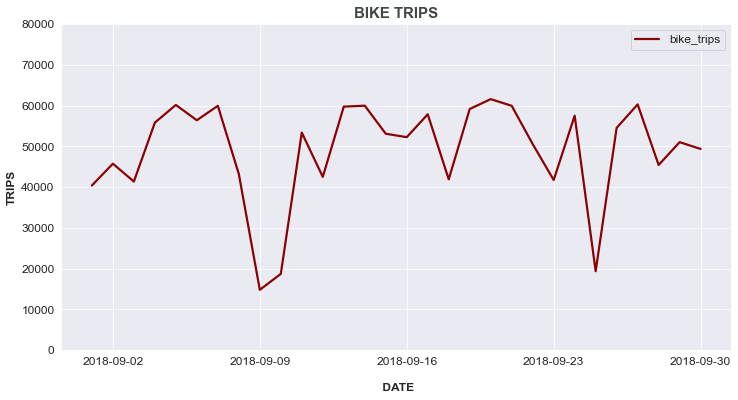

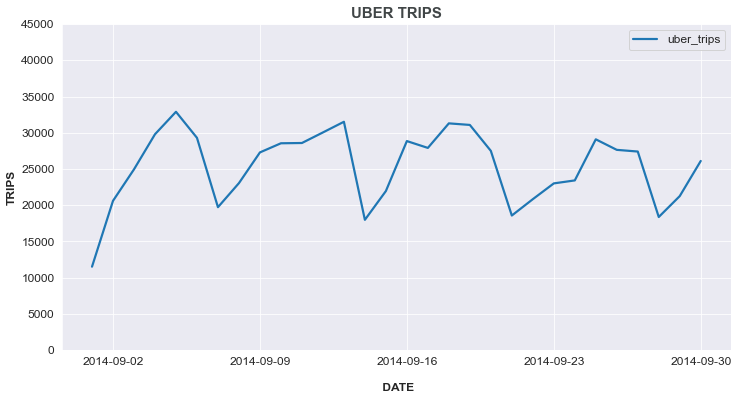

In [9]:
sns.set_style('darkgrid')

## creating auxiliary dataframes
bike_trips_per_day = bike_df.groupby(['trip_date']).size().reset_index().rename({0:'trips'}, axis = 1)
bike_trips_per_day['trip_date'] = pd.to_datetime(bike_trips_per_day['trip_date']) 
uber_trips_per_day = uber_df.groupby(['trip_date']).size().reset_index().rename({0:'trips'}, axis = 1)
uber_trips_per_day['trip_date'] = pd.to_datetime(uber_trips_per_day['trip_date']) 

#Graf 1
plt.figure(figsize=(12,6))
plt.ylim(0,80000)
plt.title("BIKE TRIPS", fontweight = 'bold', fontsize = 15, color = c_gray)
ax = sns.lineplot(data = bike_trips_per_day, x = 'trip_date', y = 'trips', linewidth = 2.2, label = 'bike_trips',
             color = 'darkred')
plt.ylabel('TRIPS', fontsize = 12, fontweight = 'bold')
plt.xlabel('\n DATE', fontsize = 12, fontweight = 'bold')
ax.xaxis.set_major_locator(mdates.DayLocator(interval=7))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
ax.tick_params(axis='y', labelsize=12)
ax.tick_params(axis='x', labelsize=12)
plt.legend(prop={'size': 12})
plt.show()

#Graf 2
print('\n')

plt.figure(figsize=(12,6))
plt.ylim(0,45000)
plt.title("UBER TRIPS", fontweight = 'bold', fontsize = 15, color = c_gray)
ax = sns.lineplot(data = uber_trips_per_day, x = 'trip_date', y = 'trips', linewidth = 2.2, label = 'uber_trips',
             color = 'tab:blue')
plt.ylabel('TRIPS', fontsize = 12, fontweight = 'bold')
plt.xlabel('\n DATE', fontsize = 12, fontweight = 'bold')
ax.xaxis.set_major_locator(mdates.DayLocator(interval=7))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
ax.tick_params(axis='y', labelsize=12)
ax.tick_params(axis='x', labelsize=12)
plt.legend(prop={'size': 12})
plt.show()


Looking at both curves, we can’t see a growing pattern. Also, as we might expect, the number of bike trips have some very low peaks, while the uber trips are more stable. That makes sense, since bike trips can be very sensible to bad weather.

Furthermore, the uber rides seem to have a strong seasonality, that is harder to spot in the bike data. Let’s dig a little deeper.

#### Trips per Day of Week and Type of Day

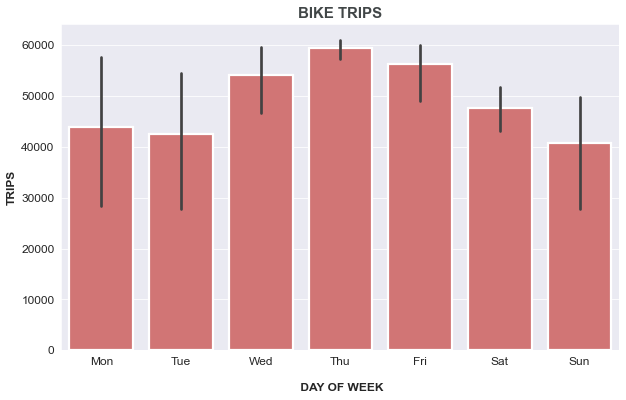

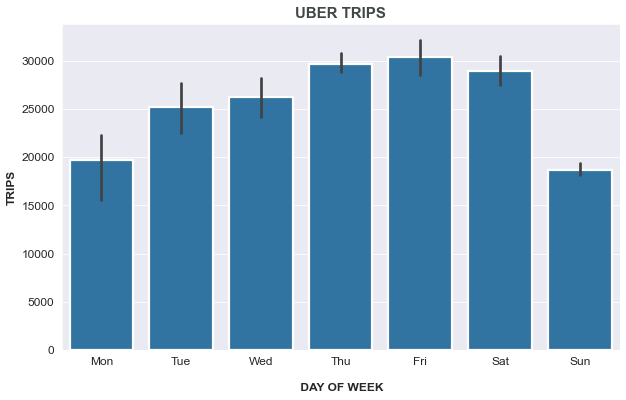

In [10]:
sns.set_style('darkgrid')

#Creating auxiliar datasets to help the plotting
bike_trips_per_dow = bike_df.groupby(['dow_trip', 'trip_date','is_weekend']).size().reset_index().rename({0:'trips'}, axis = 1)
uber_trips_per_dow = uber_df.groupby(['dow_trip', 'trip_date', 'is_weekend']).size().reset_index().rename({0:'trips'}, axis = 1)

""" We'll create 2 extra columns to make the plotting better: 
One of them is to make sure the day of weeks are in the correct order, and the other is the name abbreviated"""
dict_dow = ({'Monday':0, 'Tuesday':1, 'Wednesday':2, 'Thursday': 3, 'Friday':4, 'Saturday':5, 'Sunday':6})
dict_dow_name = ({'Monday':'Mon', 'Tuesday':'Tue', 'Wednesday':'Wed', 'Thursday': 'Thu', 'Friday':'Fri', 'Saturday':'Sat', 'Sunday':'Sun'})
bike_trips_per_dow['dow_aux'] = bike_trips_per_dow['dow_trip'].map(dict_dow)
bike_trips_per_dow['dow_mini_name'] = bike_trips_per_dow['dow_trip'].map(dict_dow_name)
uber_trips_per_dow['dow_aux'] = uber_trips_per_dow['dow_trip'].map(dict_dow)
uber_trips_per_dow['dow_mini_name'] = uber_trips_per_dow['dow_trip'].map(dict_dow_name)



### Plotting the charts

#Chart 1
plt.figure(figsize=(10,6))
plt.title("BIKE TRIPS", fontweight = 'bold', fontsize = 15, color = c_gray)
ax = sns.barplot(data = bike_trips_per_dow.sort_values(by = 'dow_aux'), x = 'dow_mini_name', y = 'trips',
             linewidth = 2.2, color = '#e06666') 
plt.ylabel('TRIPS', fontsize = 12, fontweight = 'bold')
plt.xlabel('\n DAY OF WEEK', fontsize = 12, fontweight = 'bold')

ax.tick_params(axis='y', labelsize=12)
ax.tick_params(axis='x', labelsize=12)

print('\n')

#Chart 2
plt.figure(figsize=(10,6))
plt.title("UBER TRIPS", fontweight = 'bold', fontsize = 15, color = c_gray)
ax = sns.barplot(data = uber_trips_per_dow.sort_values(by = 'dow_aux'), x = 'dow_mini_name', y = 'trips',
             linewidth = 2.2, color = 'tab:blue')
plt.ylabel('TRIPS', fontsize = 12, fontweight = 'bold')
plt.xlabel('\n DAY OF WEEK', fontsize = 12, fontweight = 'bold')
ax.tick_params(axis='y', labelsize=12)
ax.tick_params(axis='x', labelsize=12)
plt.show()

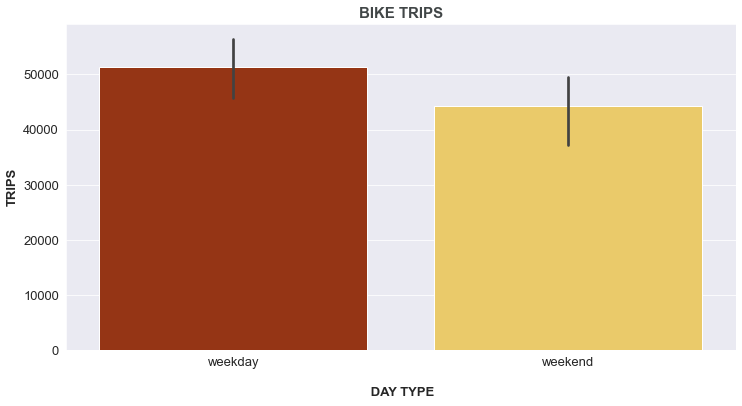

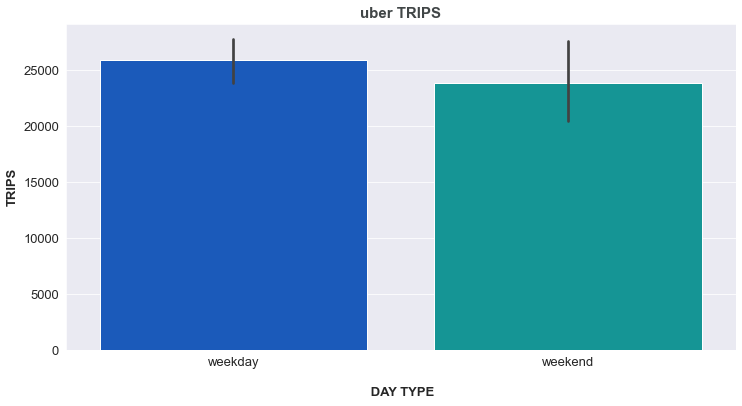

In [11]:
sns.set_style('darkgrid')

#Creating auxiliar datasets to help the plotting
bike_trips_per_day_type = bike_df.groupby(['trip_date', 'is_weekend']).size().reset_index().rename({0:'trips'}, axis = 1)
bike_trips_per_day_type['day_type'] = np.where(bike_trips_per_day_type['is_weekend']==False, 'weekday', 'weekend')
bike_trips_per_day_type.sort_values(['day_type', 'trip_date'], inplace = True)

uber_trips_per_day_type = uber_df.groupby(['trip_date', 'is_weekend']).size().reset_index().rename({0:'trips'}, axis = 1)
uber_trips_per_day_type['day_type'] = np.where(uber_trips_per_day_type['is_weekend']==False, 'weekday', 'weekend')
uber_trips_per_day_type.sort_values(['day_type', 'trip_date'], inplace = True)


#Chart 1
plt.figure(figsize=(12,6))
plt.title("BIKE TRIPS", fontweight = 'bold', fontsize = 15, color = c_gray)
ax = sns.barplot(data = bike_trips_per_day_type, x = 'day_type', y = 'trips',
             palette = 'afmhot') 
plt.ylabel('TRIPS', fontsize = 13, fontweight = 'bold')
plt.xlabel('\n DAY TYPE', fontsize = 13, fontweight = 'bold')
ax.tick_params(axis='y', labelsize=13)
ax.tick_params(axis='x', labelsize=13)
plt.show()

print('\n')

#Chart 2
plt.figure(figsize=(12,6))
plt.title("uber TRIPS", fontweight = 'bold', fontsize = 15, color = c_gray)
ax = sns.barplot(data = uber_trips_per_day_type, x = 'day_type', y = 'trips',
             palette = 'winter')
plt.ylabel('TRIPS', fontsize = 13, fontweight = 'bold')
plt.xlabel('\n DAY TYPE', fontsize = 13, fontweight = 'bold')

ax.tick_params(axis='y', labelsize=13)
ax.tick_params(axis='x', labelsize=13)
plt.show()

#### Key takeaways

- The seasonality is very clear in the uber rides, with a crescent number of trips throughout the week and a small variation. There’s also a certain pattern in the bike trips, but since the variation is bigger, this pattern is harder to spot.

- In both modes, Thursday and Friday have a large volume of trips, while Sunday and Monday have the lowest.

- The number of trips drops on the weekend. That behaviour is a little surprising to me for the bike trips, as I would expect that on the weekends there would be a lot of trips related to leisure / exercising.


Let’s take a look at how these trips are divided throughout the day, to get a better understanding on why they happen.

#### TRIPS PER HOUR

Now we are going to see when the trips happen through the day, breaking down by mode and day type. That might help us to understand the dynamic of the city and how new yorkers rely on each system: when people go to work, when they go home, what mode they use in these situations, whether they make a lot of trips outside the peak hours, etc.

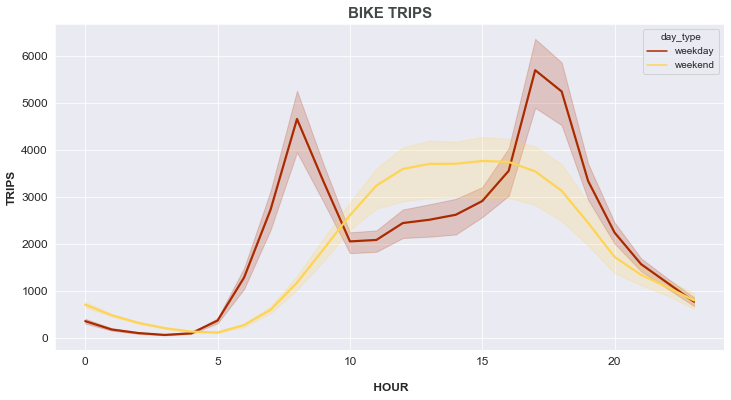

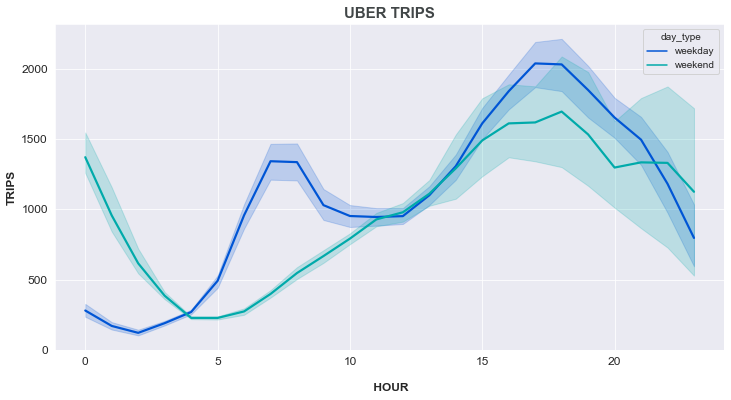

In [12]:
#Creating auxiliar datasets to help the plotting
bike_trips_per_hour = bike_df.groupby(['trip_hour', 'trip_date', 'is_weekend']).size().reset_index().rename({0:'trips'}, axis = 1)
bike_trips_per_hour['day_type'] = np.where(bike_trips_per_hour['is_weekend']==False, 'weekday', 'weekend')
bike_trips_per_hour.sort_values(['day_type', 'trip_date', 'trip_hour'], inplace = True)

uber_trips_per_hour = uber_df.groupby(['trip_hour', 'trip_date', 'is_weekend']).size().reset_index().rename({0:'trips'}, axis = 1)
uber_trips_per_hour['day_type'] = np.where(uber_trips_per_hour['is_weekend']==False, 'weekday', 'weekend')
uber_trips_per_hour.sort_values(['day_type', 'trip_date', 'trip_hour'], inplace = True)

sns.set_style('darkgrid')
#Chart 1
plt.figure(figsize=(12,6))
plt.title("BIKE TRIPS", fontweight = 'bold', fontsize = 15, color = c_gray)
ax = sns.lineplot(data = bike_trips_per_hour, x = 'trip_hour', y = 'trips',
             linewidth = 2.2, hue = 'day_type', palette = 'afmhot')# {'weekend':'#e69138', 'weekday':'#660000'}) #winter
plt.ylabel('TRIPS', fontsize = 12, fontweight = 'bold')
plt.xlabel('\n HOUR', fontsize = 12, fontweight = 'bold')
ax.tick_params(axis='y', labelsize=12)
ax.tick_params(axis='x', labelsize=12)
plt.show()

print('\n')

#Chart 2
plt.figure(figsize=(12,6))
plt.title("UBER TRIPS", fontweight = 'bold', fontsize = 15, color = c_gray)
ax = sns.lineplot(data = uber_trips_per_hour, x = 'trip_hour', y = 'trips',
             linewidth = 2.2, hue = 'day_type',  palette = 'winter')#{'weekend':'#073763', 'weekday':'#a2c4c9'})
plt.ylabel('TRIPS', fontsize = 12, fontweight = 'bold')
plt.xlabel('\n HOUR', fontsize = 12, fontweight = 'bold')
ax.tick_params(axis='y', labelsize=12)
ax.tick_params(axis='x', labelsize=12)


plt.show()

#### Key takeaways
- Looking at the bike trips on the weekdays, it is very easy to spot the morning peak (7 a.m ~ 9 a.m) and afternoon peak (17 p.m ~ 18 p.m), when people are most likely going and returning from work. Outside these hours, the trips drop substantially. The same does not happen with car trips, and these peaks (especially in the afternoon) are not so prominent. That indicates to us that most of bike trips on the weekdays are work-related, while uber trips have more diverse reasons.
- On weekends, bike trips are distributed very evenly between 10 a.m and 6 p.m. For uber trips, most of them happen after 3 pm, and they have a very solid number until the end of the day.
- As we can expect, at night, the number of bike trips is very very small, and the uber trips are quite significant. This difference is very easily spotted in the early hours of the weekend days, when there are practically no bike trips, and a huge volume of uber trips

Okay, now that we have a basic understanding of how New Yorkers use each mode, let's delve into the subject through a set of geospatial analyzes.

***
# Geospatial Analysis

Now we'll try to find patterns by looking at the districts in the city. What are the most popular neighborhoods for cyclists? These neighborhoods are also pouplar among uber users? How is the dynamics of neighborhoods with many tourist attractions? Popular districts on weekends are the same compared to weekdays? Which neighborhoods have the busiest nightlife?

We are going to generate some maps with a little help from the folium library. 

In [13]:
## setting the center of the map
y_map = 40.7612
x_map = -73.9757
center = (y_map,x_map)

## Bubble Map

First of all, let's take a look where the citibike stations are placed. To do that, we'll plot a bubble map, where each bubble will indicate the location of a station, and the size will represent the number of trips initiated in each station.

In [14]:
### create a dataset with the average of daily trips per station
df_bike_trips_per_station_1 = bike_geojson.groupby(['start_station_name', 'start_latitude', 
                                                  'start_longitude', 'trip_date']).size().to_frame().reset_index().rename({0:'trips'}, axis = 1)
df_bike_trips_per_station_2 = df_bike_trips_per_station_1.groupby(['start_station_name', 'start_latitude', 
                                                  'start_longitude']).mean()['trips'].to_frame().reset_index()

### Creating the map

## generating the background
bubble_map_daily_trips = folium.Map(center,zoom_start=12)

## generating the bubbles
for index, row in df_bike_trips_per_station_2.iterrows():
    folium.Circle(location = [row['start_latitude'], row['start_longitude']],
                    radius = row['trips']/4,
                    fill = True,
                    color = 'blue',
                    tooltip = row['start_station_name'] + ' (' + str(int(round(row['trips'],0))) + ' trips per day)',
                    fill_opacity = 0.5).add_to(bubble_map_daily_trips)

bubble_map_daily_trips

We can see that:
- There are a lot of stations and they are very well spread across Manhattan. That is a great sign: Users will most likely have a station very near their origin and destination.
- The northeast half of the city have very few trips, except for some stations close to the central park.
- Some of the busiest stations are close to other transport hubs, like the Penn Station and the Grand Central Terminal.

## Heatmap

From the previous map, we could get a good idea on how the stations are distributed, and where are the most popular regions among cyclists. For uber rides, we can't use the same kind of map, since the trips can start from basically anywhere. So, we need to use another kind of representation to analyze uber trips. We'll use a heatmap!

In [15]:
## creating a numpy array with the latitude and longitude
uber_np = uber_geojson[['start_latitude','start_longitude']].to_numpy()

#Generating the heatmap
uber_heatmap = folium.Map(center,zoom_start=12)
folium.plugins.HeatMap(uber_np,radius=12).add_to(uber_heatmap)
folium.LayerControl().add_to(uber_heatmap)
uber_heatmap

We can see some "hot spots" for uber trips, indicated by the red zones in the map: 
- In Midtown, a little southwest from the Central Park. That's understandable, since we have a lot of city landmarks, very popular among tourists.
- In the western parte, close to Chelsea - West Village 
- In the southern region, near Soho - Lower Manhattan

In the next steps, we are going to generate a new set of maps to try to visualize some metrics over the city. To do that, we'll use a Choropleth maps from now on.

## Choropleth

Choropleth maps are a great way to visualize how a certain measure varies across geographic units. Each region (in our case, the neighborhoods) will be represented  with a slightly different color according to the intensity of the variable we are analyzing. As colors tend to vary with a linear scale, along with the intensity of the variable, these kinds of maps are very powerful to highlight patterns in our data.

In [16]:
y_map = 40.7712
x_map = -73.9757
center = (y_map,x_map)

First, we'll just create the maps just with the number of trips: First breaking down by modal, and then breaking down by mode + type of day.

### Uber Trips - Total

In [17]:
## Creating the auxiliary datasets
df_trips_per_district_per_day_uber = uber_geojson.groupby(['ntaname', 'trip_date']).size().to_frame().reset_index().rename({0:'trips'}, axis = 1)
df_trips_per_district_uber = df_trips_per_district_per_day_uber.groupby('ntaname').mean()['trips'].round().to_frame().reset_index().rename({0:'trips'}, axis = 1)

## Creating the map
generate_choropleth_map(df = df_trips_per_district_uber, value_to_plot = 'trips', alias_label = 'trips', legend = 'Daily Trips')

### Bike Trips - Total

In [18]:
## Creating the auxiliary datasets
df_trips_per_district_per_day_bike = bike_geojson.groupby(['ntaname', 'trip_date']).size().to_frame().reset_index().rename({0:'trips'}, axis = 1)
df_trips_per_district_bike = df_trips_per_district_per_day_bike.groupby('ntaname').mean()['trips'].to_frame().reset_index().rename({0:'trips'}, axis = 1)

## Creating the map
generate_choropleth_map(df_trips_per_district_bike, value_to_plot = 'trips', alias_label = 'trips', legend = 'Daily Trips')

### Uber Trips - Weekday 

In [19]:
## Creating the auxiliary datasets
df_trips_per_district_per_day_uber_weekeday = uber_geojson.query('is_weekend == False').groupby(['ntaname', 'trip_date']).size().to_frame().reset_index().rename({0:'trips'}, axis = 1)
df_trips_per_district_uber_weekday = df_trips_per_district_per_day_uber_weekeday.groupby('ntaname').mean()['trips'].to_frame().reset_index().rename({0:'trips'}, axis = 1)

generate_choropleth_map(df_trips_per_district_uber_weekday,value_to_plot = 'trips', alias_label = 'trips', legend = 'Daily Trips')

### Bike Trips - Weekday 

In [20]:
## Creating the auxiliary datasets
df_trips_per_district_per_day_bike_weekeday = bike_geojson.query('is_weekend == False').groupby(['ntaname', 'trip_date']).size().to_frame().reset_index().rename({0:'trips'}, axis = 1)
df_trips_per_district_bike_weekday = df_trips_per_district_per_day_bike_weekeday.groupby('ntaname').mean()['trips'].to_frame().reset_index().rename({0:'trips'}, axis = 1)

## Creating the map
generate_choropleth_map(df_trips_per_district_bike_weekday,value_to_plot = 'trips', alias_label = 'trips', legend = 'Daily Trips')

### Uber Trips - Weekend 

In [21]:
## Creating the auxiliary datasets
df_trips_per_district_per_day_uber_weekend = uber_geojson.query('is_weekend == True').groupby(['ntaname', 'trip_date']).size().to_frame().reset_index().rename({0:'trips'}, axis = 1)
df_trips_per_district_uber_weekend = df_trips_per_district_per_day_uber.groupby('ntaname').mean()['trips'].to_frame().reset_index().rename({0:'trips'}, axis = 1)

## Creating the map
generate_choropleth_map(df_trips_per_district_uber_weekend,value_to_plot = 'trips', alias_label = 'trips', legend = 'Daily Trips')

### Bike Trips - Weekend 

In [22]:
## Creating the auxiliary datasets
df_trips_per_district_per_day_bike_weekend = bike_geojson.query('is_weekend == True').groupby(['ntaname', 'trip_date']).size().to_frame().reset_index().rename({0:'trips'}, axis = 1)
df_trips_per_district_bike_weekend = df_trips_per_district_per_day_bike_weekend.groupby('ntaname').mean()['trips'].to_frame().reset_index().rename({0:'trips'}, axis = 1)

## Creating the map
generate_choropleth_map(df_trips_per_district_bike_weekend,value_to_plot = 'trips', alias_label = 'trips', legend = 'Daily Trips')

#### Key takeaways
- Even though we can spot some difference between modes, the general pattern is very similar: In both cases, it's easy to spot the movement to the northeast of the city is much smaller than the rest. Also, even though the rank is a little different, the 4 more popular neighborhoods are the same for bikes and uber users.
- For the citibike, the trips seem to be a little more spreaded, and we can see more bluish districts in the southern region
- The central park district is clearly very important among cyclists, but for the uber users, that is harder to spot, since there are very few trips that started at the park, and they most likely started at the adjacent districts.
- The Midtown/Midtown south neighborhood is probably the most popular among tourists, since it have A LOT of important landmarks, such as the Times Square, Empire State Building, Rockafeller Center, Madison Square, St Patrick Cathedral, among others. We can see that for this district, uber rides are more representative than the bike rides.

### Week vs Weekend 
***
*First, an asterisk: In the next analysis, we'll be joining bike trips and uber trips in the same map. As we mentioned, the trips from each modal have a four year difference, and since a lot can change in that period, I'd rather not to have a modal with a greater influence on the result than the other based on the absolute number of trips. Therefore, it will be made an adjustment to make sure that bike trips and uber trips have the same weight.*


Until now, we focused a lot on the comparassion between uber and bikes. Now, we'll turn our attentions to understanding the difference between weekdays and weekends.

Let's generate a map with the weekend index, that is basically the average of trips from each neighborhood on weekends divided by the same metric on weekdays. A high weekend index indicate a district with a lot of its trips on weekends. Note that the index itself is not relevant, since we are mixing values with a 4 years difference. What matters the most is the color contrast between regions.

In [23]:
## creating a multiplier to make sure that bike and uber trips will have the same "weight"
correction_multiplier_uber = bike_df.shape[0]/uber_df.shape[0]

#### Creating the auxiliary datasets
## we are going to use the dataset created previously. We just need to rename the 'trips columns'
df_trips_per_district_uber_weekend = df_trips_per_district_uber_weekend.rename({'trips':'trips_uber_wkd'}, axis = 1)
df_trips_per_district_uber_weekday = df_trips_per_district_uber_weekday.rename({'trips':'trips_uber_week'}, axis = 1)
df_trips_per_district_bike_weekend = df_trips_per_district_bike_weekend.rename({'trips':'trips_bike_wkd'}, axis = 1)
df_trips_per_district_bike_weekday = df_trips_per_district_bike_weekday.rename({'trips':'trips_bike_week'}, axis = 1)

## joining all of them, to have the trips_uber_wkd, trips_uber_week, trips_bike_wkd, trips_bike_week in the same df
df_week_weekend = df_trips_per_district_uber_weekend.merge(df_trips_per_district_uber_weekday, on = 'ntaname', how = 'left')
df_week_weekend = df_week_weekend.merge(df_trips_per_district_bike_weekend, on = 'ntaname', how = 'left')
df_week_weekend = df_week_weekend.merge(df_trips_per_district_bike_weekday, on = 'ntaname', how = 'left')

## multiplying the uber trips for the correction multipler, so the uber trips will have the same weight as the bike trips
df_week_weekend['trips_uber_wkd'] = df_week_weekend['trips_uber_wkd'].apply(lambda x: x*correction_multiplier_uber)
df_week_weekend['trips_uber_week'] = df_week_weekend['trips_uber_week'].apply(lambda x: x*correction_multiplier_uber)

## create the weekend index
df_week_weekend['weekend_index'] = (df_week_weekend['trips_uber_wkd'] + df_week_weekend['trips_bike_wkd'])/(df_week_weekend['trips_uber_week'] + df_week_weekend['trips_bike_week'])
df_week_weekend['weekend_index'].fillna(df_week_weekend['weekend_index'].median(), inplace = True)

## Creating the map
generate_choropleth_map(df_week_weekend, value_to_plot = 'weekend_index', alias_label = 'weekend_index', legend = 'weekend_index', div = 8)

We could see a couple of interesting things:
- The district that contains the Central Park has far more trips on a weekend day than on a weekday.
- In general, the neighborhoods on the northeast half of the city have more trips at weekends. 
- Upper West Side and Chinatown are two districts with most of its movement at weekends!
- Midtown/Midtown South, Turtle Bay/East Midtown and Murray Hill/Kips Bay are districts with a higher number of trips at weekdays. 
- It's a little intriguing to see how Midtown/Midtown South have a relative low engagement on weekends, considering they have so many tourists attractions, and therefore a lot of potential to drive visitors. This probably happens because most of the traffic on the region might be related to the local workers, that aren't at duty on weekends.

### Period of the Day
***

Now, we'll do a similar exercise looking at the time of the day (morning, afternoon or night). We'll generate 3 maps, that will be colored base on an index that represents the % of trips that started in that given period. For example: The morning index for the Upper West Side is 37.7. That means that 37,7% of the trips initiated in that neighborhood started in the morning.

#### Morning Trips

In [24]:
# creating a dataset with the morning index for uber rides
df_morning_uber1 = pd.DataFrame(uber_geojson.query('time_of_day=="morning"').groupby(['ntaname', 'trip_date']).size()/uber_geojson.groupby(['ntaname', 'trip_date']).size()).reset_index().rename({0:'morning_index_uber'}, axis = 1)
df_morning_uber2= df_morning_uber1.groupby('ntaname').mean()['morning_index_uber'].to_frame().reset_index()

# creating a dataset with the morning index for bikes
df_morning_bike1 = pd.DataFrame(bike_geojson.query('time_of_day=="morning"').groupby(['ntaname', 'trip_date']).size()/bike_geojson.groupby(['ntaname', 'trip_date']).size()).reset_index().rename({0:'morning_index_bike'}, axis = 1)
df_morning_bike2 = df_morning_bike1.groupby('ntaname').mean()['morning_index_bike'].to_frame().reset_index()

# joining them together: the final index will be the average of them
df_morning2 = df_morning_uber2.merge(df_morning_bike2, on = 'ntaname')
df_morning2['morning_index'] = (df_morning2['morning_index_bike']+df_morning2['morning_index_uber'])/2*100

## Creating the map
generate_choropleth_map(df_morning2,value_to_plot = 'morning_index', alias_label = 'morning_index', legend = 'morning_index', div = 8)


### Afternoon trips

In [25]:
# creating a dataset with the afternoon index for uber rides
df_afternoon_uber1 = pd.DataFrame(uber_geojson.query('time_of_day=="afternoon"').groupby(['ntaname', 'trip_date']).size()/uber_geojson.groupby(['ntaname', 'trip_date']).size()).reset_index().rename({0:'afternoon_index_uber'}, axis = 1)
df_afternoon_uber2 = df_afternoon_uber1.groupby('ntaname').mean()['afternoon_index_uber'].to_frame().reset_index()

# creating a dataset with the afternoon index for bikes
df_afternoon_bike1 = pd.DataFrame(bike_geojson.query('time_of_day=="afternoon"').groupby(['ntaname', 'trip_date']).size()/bike_geojson.groupby(['ntaname', 'trip_date']).size()).reset_index().rename({0:'afternoon_index_bike'}, axis = 1)
df_afternoon_bike2 = df_afternoon_bike1.groupby('ntaname').mean()['afternoon_index_bike'].to_frame().reset_index()

# joining them together: the final index will be the average of them
df_afternoon2 = df_afternoon_uber2.merge(df_afternoon_bike2, on = 'ntaname')
df_afternoon2['afternoon_index'] = (df_afternoon2['afternoon_index_bike']+df_afternoon2['afternoon_index_uber'])/2*100

## Creating the map
generate_choropleth_map(df_afternoon2, value_to_plot = 'afternoon_index', alias_label = 'afternoon_index', legend = 'afternoon_index', div = 8)


### Night Trips

In [26]:
# creating a dataset with the night index for uber rides
df_night_uber1 = pd.DataFrame(uber_geojson.query('time_of_day=="night"').groupby(['ntaname', 'trip_date']).size()/uber_geojson.groupby(['ntaname', 'trip_date']).size()).reset_index().rename({0:'night_index_uber'}, axis = 1)
df_night_uber2 = df_night_uber1.groupby('ntaname').mean()['night_index_uber'].to_frame().reset_index()

# creating a dataset with the night index for bikes
df_night_bike1 = pd.DataFrame(bike_geojson.query('time_of_day=="night"').groupby(['ntaname', 'trip_date']).size()/bike_geojson.groupby(['ntaname', 'trip_date']).size()).reset_index().rename({0:'night_index_bike'}, axis = 1)
df_night_bike2 = df_night_bike1.groupby('ntaname').mean()['night_index_bike'].to_frame().reset_index()

# joining them together: the final index will be the average of them
df_night2 = df_night_uber2.merge(df_night_bike2, on = 'ntaname')
df_night2['night_index'] = (df_night2['night_index_bike']+df_night2['night_index_uber'])/2*100

## Creating the map
generate_choropleth_map(df_night2, value_to_plot = 'night_index', alias_label = 'night_index', legend = 'night_index', div = 7)


We could see a couple of interesting things:
- The top districts don't have a large percentage of trips in the morning
- Upper West Side, Yorkville and Stuyvesan Town/Cooper Village are districts with a relative high movement in the morning
- For almost every district, the afternoon is the period with the highest percentage of its trips.
- Central Park, Upper East Side, Battery Park City /Lower Manhattan are the districts with the highest percentage of trips in the afternoon
- West Village,  East Village and Chinatown are the districts with greater percentage of its movement at night.


## Timelapse
To wrap it up, let's create a time lapse of the trips in Manhattan, this will give us a full and more complete view on how both modes are used. For example: The neighborhoods that are popular at 1 p.m, might not be the same that are popular at 5 p.m, and in our previous maps, we coudn't see that with that level of detail.

We'll create 4 gifs: Bike Trips at Weekdays, Bike Trips at Weekends, Uber Trips at Weekdays and Uber Trips at Weekends.

<img src="bike_week.gif" width="750" align="center">

<img src="bike_weekend.gif" width="750" align="center">

<img src="uber_week.gif" width="750" align="center">

<img src="uber_weekend.gif" width="750" align="center">

In [27]:
assert 5=2

SyntaxError: invalid syntax (<ipython-input-27-832f7409a9e0>, line 1)

## Creating Gif

In [ ]:
def save_clmap_png(df, hour, folder_name, quick_summary, title):
    """
    Receives a dataset, a time of the day, and generates a choropleth map, with a 'picture' 
    of the city in that given time, and saves into a folder.
    """
    
    ## get the highest value of trips in any district, in any time. That will be used as a reference for the color scale
    max_value = df.groupby(['ntaname', 'trip_date', 'trip_hour']).size().to_frame().reset_index().rename({0:'trips'}, axis = 1).max()['trips']
    
    ## creating a dataset with the hour filtered. We need to do a little trick to make sure every district is presented, regardless the filter
    df_filter = df[df['trip_hour']==hour]
    df_filter_group_pday = df_filter.groupby(['ntaname', 'trip_date']).size().to_frame().reset_index().rename({0:'trips'}, axis = 1)
    df_filter_group1 = df_filter_group_pday.groupby('ntaname').mean()['trips'].to_frame()
    df_schema = pd.DataFrame(list(product(df['ntaname'].unique(),[hour])), columns=['ntaname', 'trip_hour'])
    df_filter_group2 = df_schema.merge(df_filter_group1, how = 'left', on = ['ntaname']) 
    
    ## join the nyc map with the df create
    df_final = pd.merge(nyc_neighborhoods_map, df_filter_group2, on = 'ntaname')
    
    ## fill nulls with 0
    df_final['trips'] = df_final['trips'].fillna(0)
    
    ## setting some parameters for the map
    style_function = lambda x: {'fillColor': '#ffffff', 
                                'color':'#000000', 
                                'fillOpacity': 0.1, 
                                'weight': 0.1}
    highlight_function = lambda x: {'fillColor': '#000000', 
                                    'color':'#000000', 
                                    'fillOpacity': 0.50, 
                                    'weight': 0.1}
    
    ## create the map
    mymap = folium.Map(location=[y_map, x_map], zoom_start=12,tiles=None)
    folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(mymap)

    ## create the color scale thresholds
    myscale = [i*max_value/7 for i in range(8)]
    
    ## create the map
    folium.Choropleth(
    geo_data=df_final,
    name='Choropleth',
    data=df_final,
    columns=['ntaname','trips'],
    key_on="feature.properties.ntaname",
    fill_color='YlGnBu',
    threshold_scale=myscale,
    fill_opacity=1,
    line_opacity=0.5,
    legend_name='Hourly Trips',
    smooth_factor=0).add_to(mymap)
    

    ## create the interactive legend of the map
    NIL = folium.features.GeoJson(
        df_final,
        style_function=style_function, 
        control=False,
        highlight_function=highlight_function, 
        tooltip=folium.features.GeoJsonTooltip(
            fields=['ntaname', 'trips'],
            aliases=['Neighborhood:', 'Number of Trips:'],
            style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
        )
    )

    mymap.add_child(NIL)
    mymap.keep_in_front(NIL)
    folium.LayerControl().add_to(mymap)
    
    ## create the title
    loc = '{}'.format(title)
    title_html = '''
             <h3 align="center" style="font-size:19px"><b>{}</b></h3>
             '''.format(loc)  
    mymap.get_root().html.add_child(folium.Element(title_html))

    ## save as html
    delay=5
    fn='auxmap.html'
    tmpurl='file://{path}//{mapfile}'.format(path=os.getcwd(),mapfile=fn)
    mymap.save(fn)
    
    ## save as png
    browser = webdriver.Chrome()
    browser.get(tmpurl)

    #Give the map tiles some time to load
    time.sleep(delay)
    
    ## create a folder with the name indicated on the function call    
    try:
        path = '{}\\{}'.format(os.getcwd(),folder_name)
        os.mkdir(path)
    except:
        pass
    
    ## make sure that the folder was created
    time.sleep(3)
    
    ## correct the time strins, to add a 0 for 1 digit hours
    if hour <= 9:
        st_hour = '0'+str(hour)
    else:
        st_hour = str(hour)
    
    ## save the screenshot in the folder
    browser.save_screenshot('{}/map_{}_{}.png'.format(folder_name, quick_summary, st_hour))
    browser.quit()
    

def generate_string_hour(st):
    """ Get a number, and return a string with a am/pm value """
    if st > 12:
        str_hor = '{} p.m'.format(st-12)
    elif st < 12:
        str_hor = '{} a.m'.format(st)
    else:
        str_hor = '12 p.m'
    return str_hor

def generate_gif(df, list_hour, folder_name, quick_summary, title):
    """ Receives a dataframe, and creates a gif hours passed in the list of the function."""
    
    ## get current path
    or_path = os.getcwd()
    
    ## save an image for every hour in the list
    for hour in list_hour:
        str_hor = generate_string_hour(hour)
        title_new = title + '- ' + str_hor
        save_clmap_png(df, hour, folder_name, quick_summary, title_new)
    
    ## move to the folder where the images where generated
    new_path = os.getcwd()+'\\{}'.format(folder_name)
    os.chdir(new_path)
    
    ## create a gif with all the images created
    png_files = [f for f in os.listdir() if f[-4:]=='.png']
    png_paths = ['{}/'.format(os.getcwd())+f for f in png_files]
    images = []    
    for filename in png_paths:
        images.append(imageio.imread(filename))
    images.append(imageio.imread(filename))
    images.append(imageio.imread(filename))
    imageio.mimwrite('gifmap_{}.gif'.format(quick_summary), images, fps=2)
    os.chdir(or_path)


In [ ]:
generate_gif(bike_geojson.query('is_weekend == False'), [i for i in range(24)], 'bike_week', 'bike_week','Bike Trips at Weekdays')


In [ ]:
generate_gif(bike_geojson.query('is_weekend == True'), [i for i in range(24)], 'bike_weekend', 'bike_weekend','Bike Trips at Weekends')


In [ ]:
generate_gif(uber_geojson.query('is_weekend == False'),[i for i in range(24)], 'uber_week', 'uber_week','Uber Trips at Weekdays')


In [ ]:
generate_gif(uber_geojson.query('is_weekend == True'),[i for i in range(24)], 'uber_weekend', 'uber_weekend','Uber Trips at Weekends')
